In [ ]:
data ='/content/drive/MyDrive/Desktop/PCB_DATASET'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Import all the necessary libraries**


In [ ]:
import pandas as pd
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
from tqdm import tqdm
import argparse
import glob
import xml.etree.ElementTree as ET
import cv2
import ast
import numpy as np


import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as immg

import random

import torch

import torchvision
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN

from tqdm.notebook import tqdm
from sklearn.model_selection import train_test_split
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"


import warnings
warnings.filterwarnings("ignore")

In [ ]:
# !pip install albumentations==0.4.6
import albumentations as A
from albumentations.pytorch import ToTensorV2

**Generate a  CSV**


In [ ]:
path_an = "/content/drive/MyDrive/Desktop/PCB_DATASET/Annotations"
print(path_an)

/content/drive/MyDrive/Desktop/PCB_DATASET/Annotations


In [ ]:
dataset = {
            "xmin":[],
            "ymin":[],
            "xmax":[],
            "ymax":[],
            "class":[],
            "file":[],
            "width":[],
            "height":[],
           }
all_files = []
for path, subdirs, files in os.walk(path_an):
#     print([path, subdirs, files])
    for name in files:
        all_files.append(os.path.join(path, name))

# print(all_files)
print(type(dataset))
print(dataset)

<class 'dict'>
{'xmin': [], 'ymin': [], 'xmax': [], 'ymax': [], 'class': [], 'file': [], 'width': [], 'height': []}


In [ ]:
for anno in all_files:
    # print(anno)
    tree = ET.parse(anno)

    for elem in tree.iter():
        # print(elem)

        if 'size' in elem.tag:
            # print('[size] in elem.tag ==> list(elem)\n'), print(list(elem))
            for attr in list(elem):
                if 'width' in attr.tag:
                    width = int(round(float(attr.text)))
                if 'height' in attr.tag:
                    height = int(round(float(attr.text)))

        if 'object' in elem.tag:
            # print('[object] in elem.tag ==> list(elem)\n'), print(list(elem))
            for attr in list(elem):

                # print('attr = %s\n' % attr)
                if 'name' in attr.tag:
                    name = attr.text
                    dataset['class']+=[name]
                    dataset['width']+=[width]
                    dataset['height']+=[height]
                    dataset['file']+=[anno.split('/')[-1][0:-4]]

                if 'bndbox' in attr.tag:
                    for dim in list(attr):
                        if 'xmin' in dim.tag:
                            xmin = int(round(float(dim.text)))
                            dataset['xmin']+=[xmin]
                        if 'ymin' in dim.tag:
                            ymin = int(round(float(dim.text)))
                            dataset['ymin']+=[ymin]
                        if 'xmax' in dim.tag:
                            xmax = int(round(float(dim.text)))
                            dataset['xmax']+=[xmax]
                        if 'ymax' in dim.tag:
                            ymax = int(round(float(dim.text)))
                            dataset['ymax']+=[ymax]

In [ ]:
data=pd.DataFrame(dataset)
print(data)
data.shape

      xmin  ymin  xmax  ymax         class                file  width  height
0     2199   831  2262   917          spur          04_spur_07   3056    2464
1      922  1091   997  1173          spur          04_spur_07   3056    2464
2     2410  1362  2479  1448          spur          04_spur_07   3056    2464
3     1959  1326  2008  1431          spur          04_spur_12   3056    2464
4      659  1219   759  1268          spur          04_spur_12   3056    2464
...    ...   ...   ...   ...           ...                 ...    ...     ...
2948   857   197   913   253  missing_hole  06_missing_hole_08   2868    2316
2949   243  1164   315  1222  missing_hole  06_missing_hole_08   2868    2316
2950  2075  1034  2139  1087  missing_hole  01_missing_hole_15   3034    1586
2951  2470  1105  2526  1158  missing_hole  01_missing_hole_15   3034    1586
2952  2077   514  2135   572  missing_hole  01_missing_hole_15   3034    1586

[2953 rows x 8 columns]


(2953, 8)

**Readind CSV file**

In [ ]:
# partition the data into training and testing splits using 80% of
# the data for training and the remaining 20% for testing
train, test = train_test_split(data, shuffle=True, test_size=0.2, random_state=34)

In [ ]:
train.shape, test.shape

((2362, 8), (591, 8))

In [ ]:
train.head()

,xmin,ymin,xmax,ymax,class,file,width,height
1838,415,762,490,803,mouse_bite,06_mouse_bite_09,2868,2316
2149,1633,463,1724,564,short,01_short_16,3034,1586
1784,981,567,1052,612,mouse_bite,05_mouse_bite_09,2544,2156
1042,395,506,455,564,open_circuit,04_open_circuit_04,3056,2464
1992,1993,1159,2050,1217,short,06_short_02,2868,2316


In [ ]:
test.head()

,xmin,ymin,xmax,ymax,class,file,width,height
90,701,427,817,486,spur,07_spur_06,2904,1921
1315,2234,680,2266,732,open_circuit,08_open_circuit_08,2759,2154
1244,1314,1867,1375,1947,open_circuit,11_open_circuit_10,2282,2248
1572,1683,638,1723,677,mouse_bite,01_mouse_bite_03,3034,1586
1515,1666,523,1713,600,mouse_bite,09_mouse_bite_07,2775,2159


In [ ]:
classes_la = {"missing_hole": 0, "mouse_bite": 1, "open_circuit":2, "short": 3, 'spur': 4,'spurious_copper':5}

train["class"] = train["class"].apply(lambda x: classes_la[x])
test["class"] = test["class"].apply(lambda x: classes_la[x])

In [ ]:
train.head()

,xmin,ymin,xmax,ymax,class,file,width,height
1838,415,762,490,803,1,06_mouse_bite_09,2868,2316
2149,1633,463,1724,564,3,01_short_16,3034,1586
1784,981,567,1052,612,1,05_mouse_bite_09,2544,2156
1042,395,506,455,564,2,04_open_circuit_04,3056,2464
1992,1993,1159,2050,1217,3,06_short_02,2868,2316


In [ ]:
test.head()

,xmin,ymin,xmax,ymax,class,file,width,height
90,701,427,817,486,4,07_spur_06,2904,1921
1315,2234,680,2266,732,2,08_open_circuit_08,2759,2154
1244,1314,1867,1375,1947,2,11_open_circuit_10,2282,2248
1572,1683,638,1723,677,1,01_mouse_bite_03,3034,1586
1515,1666,523,1713,600,1,09_mouse_bite_07,2775,2159


**Visualization**


In [ ]:
# PJC (deep copy)
df = train.copy()

df_grp = df.groupby(['file'])
print(df_grp)

In [ ]:
df_grp.size()

file
01_missing_hole_01       3
01_missing_hole_02       2
01_missing_hole_03       3
01_missing_hole_04       2
01_missing_hole_05       3
                        ..
12_spurious_copper_06    4
12_spurious_copper_07    5
12_spurious_copper_08    5
12_spurious_copper_09    4
12_spurious_copper_10    3
Length: 692, dtype: int64

In [ ]:
image_name = '01_missing_hole_02'
image_group = df_grp.get_group(image_name)
print(image_group)

      xmin  ymin  xmax  ymax  class                file  width  height
2457  2366   803  2406   860      0  01_missing_hole_02   3034    1586
2458  1506   802  1559   856      0  01_missing_hole_02   3034    1586


In [ ]:
bbox = image_group.loc[:,['xmin', 'ymin', 'xmax', 'ymax']]
print([bbox, type(bbox)])

[      xmin  ymin  xmax  ymax
2457  2366   803  2406   860
2458  1506   802  1559   856, <class 'pandas.core.frame.DataFrame'>]


In [ ]:
def plot_image(image_name):
    print(image_name)
    image_group = df_grp.get_group(image_name)
    bbox = image_group.loc[:,['xmin', 'ymin', 'xmax', 'ymax']]
    path ="/content/drive/MyDrive/Desktop/PCB_DATASET/images/"
    if "missing" in name.split('_'):
        path += 'Missing_hole/'
    if "mouse" in name.split('_'):
        path += 'Mouse_bite/'
    if "open" in name.split('_'):
        path += 'Open_circuit/'
    if "short" in name.split('_'):
        path += 'Short/'
    if "spur" in name.split('_'):
        path += 'Spur/'
    if "spurious" in name.split('_'):
        path += 'Spurious_copper/'

    img = immg.imread(path+""+name+'.jpg')
    fig,ax = plt.subplots(figsize=(18,10))
    ax.imshow(img,cmap='binary')
    for i in range(len(bbox)):
        box = bbox.iloc[i].values
        print(box)
        x,y,w,h = box[0], box[1], box[2]-box[0], box[3]-box[1]
        rect = matplotlib.patches.Rectangle((x,y),w,h,linewidth=1,edgecolor='r',facecolor='none',)
        # ax.text(*box[:2], image_group["class"].values, verticalalignment='top', color='white', fontsize=13, weight='bold')
        ax.add_patch(rect)
    plt.show()

01_missing_hole_03
[2651  487 2700  531]
[2082  582 2135  620]
[1342  749 1393  796]


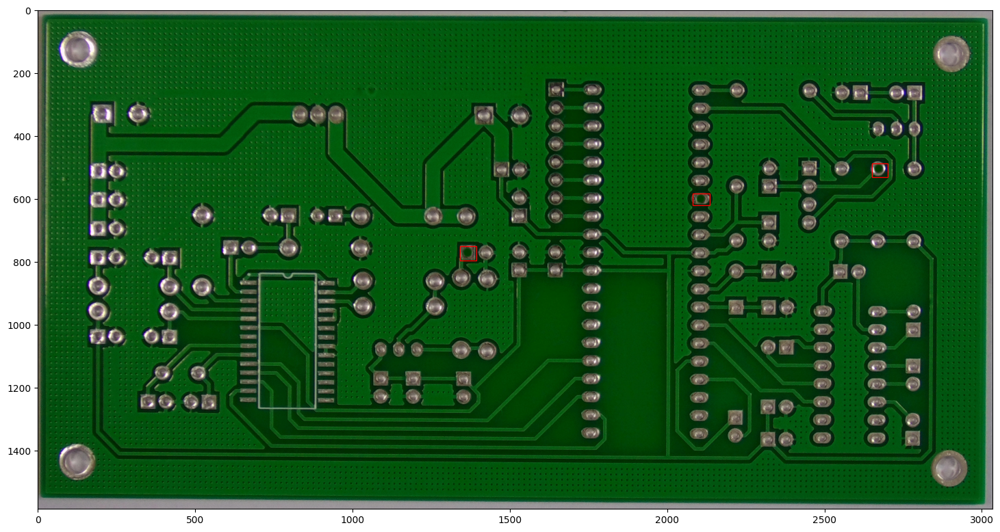

In [ ]:
name = '01_missing_hole_03'
plot_image(name)

07_spurious_copper_02
[1523  655 1630  710]
[1951  500 2036  586]
[1173 1296 1318 1346]


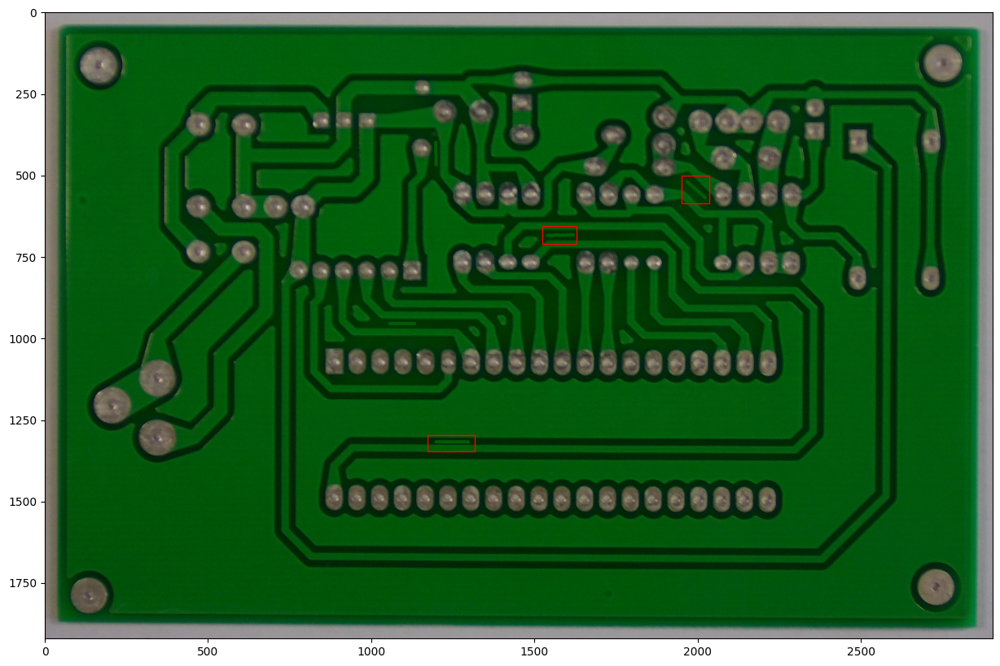

In [ ]:
name = train.file[500]
plot_image(name)

08_spur_03
[2378 1295 2420 1398]
[ 800 1205  925 1256]
[1682  905 1741  995]
[2022  721 2081  834]


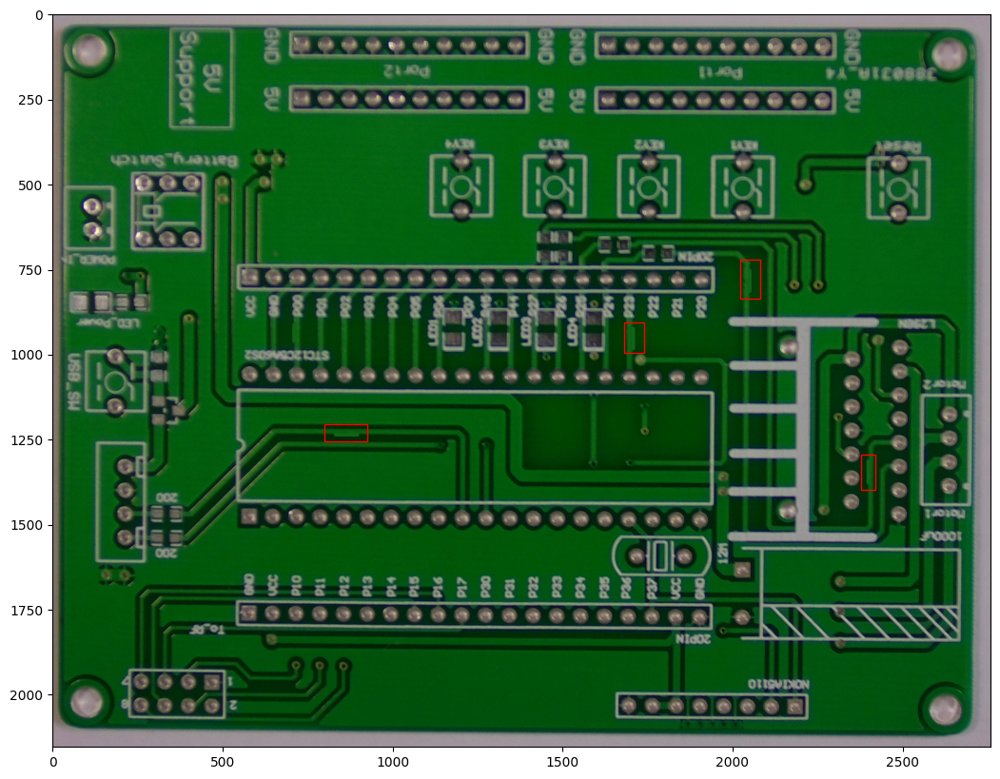

In [ ]:
name = train.file[100]
plot_image(name)

01_spur_16
[2129  980 2175 1020]
[2295 1289 2331 1328]
[2419 1105 2467 1146]


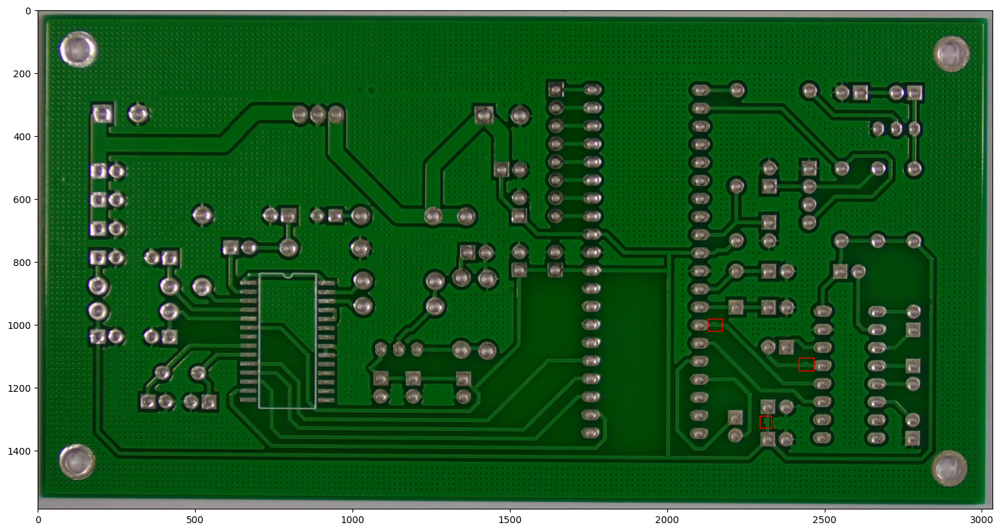

In [ ]:
name = train.file[105]
plot_image(name)

06_spur_08
[2474 1364 2540 1419]
[1643 2051 1777 2112]
[2537 1837 2593 1942]
[1018 1276 1054 1378]
[1304 1673 1355 1744]


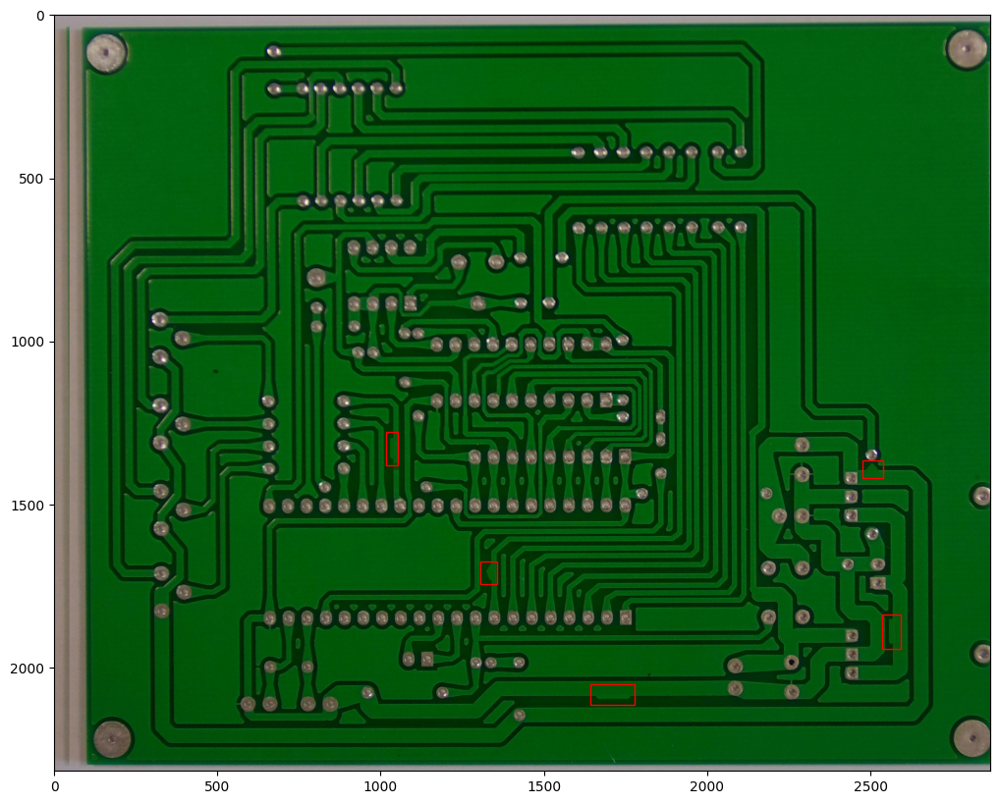

In [ ]:

name = train.file[110]
plot_image(name)

05_spur_08
[ 570 1304  661 1368]
[1542  638 1625  696]
[661 634 767 699]
[1924 1362 2017 1417]


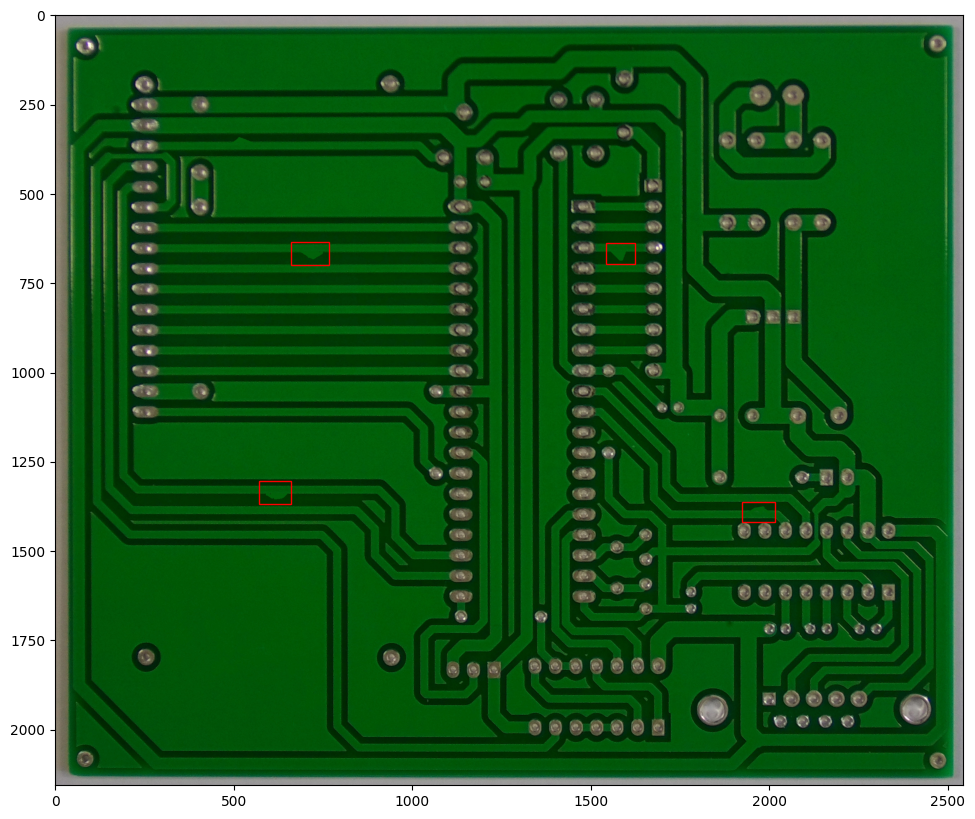

In [ ]:
name = train.file[125]
plot_image(name)

04_spur_13
[2110  410 2184  459]
[2166  877 2224  962]
[ 521 2277  595 2337]


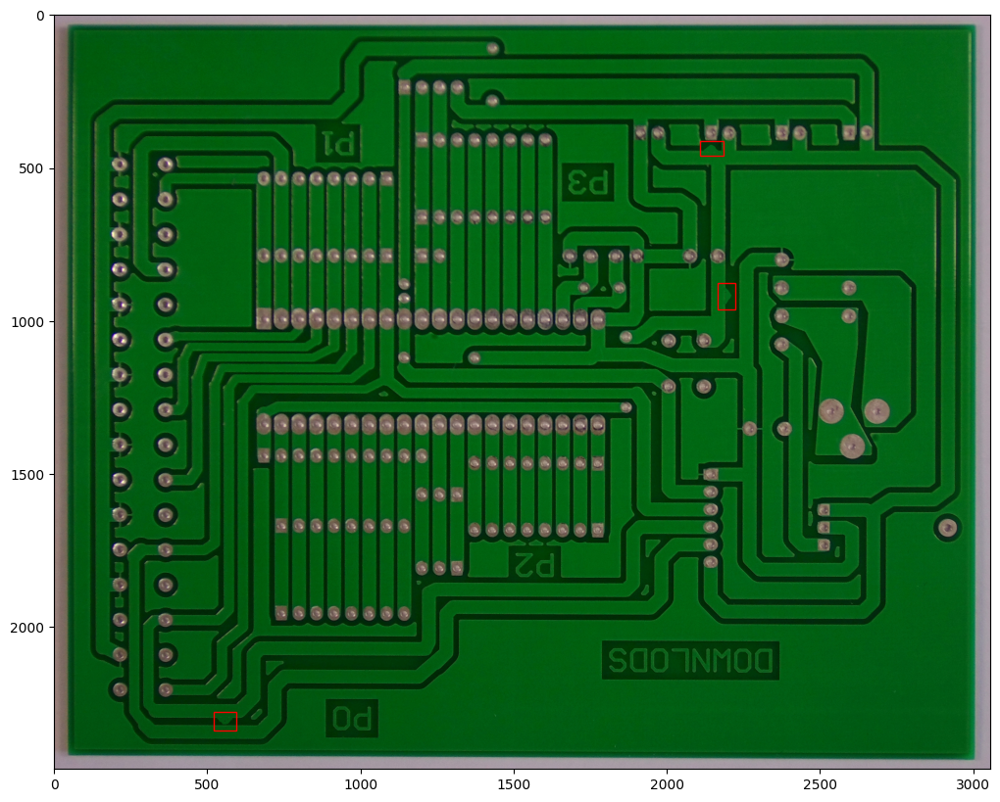

In [ ]:
name = train.file[195]
plot_image(name)

11_spur_10
[866 331 939 429]
[725 845 843 911]
[ 666 1944  794 2008]
[768 594 893 688]
[ 325 1094  401 1219]


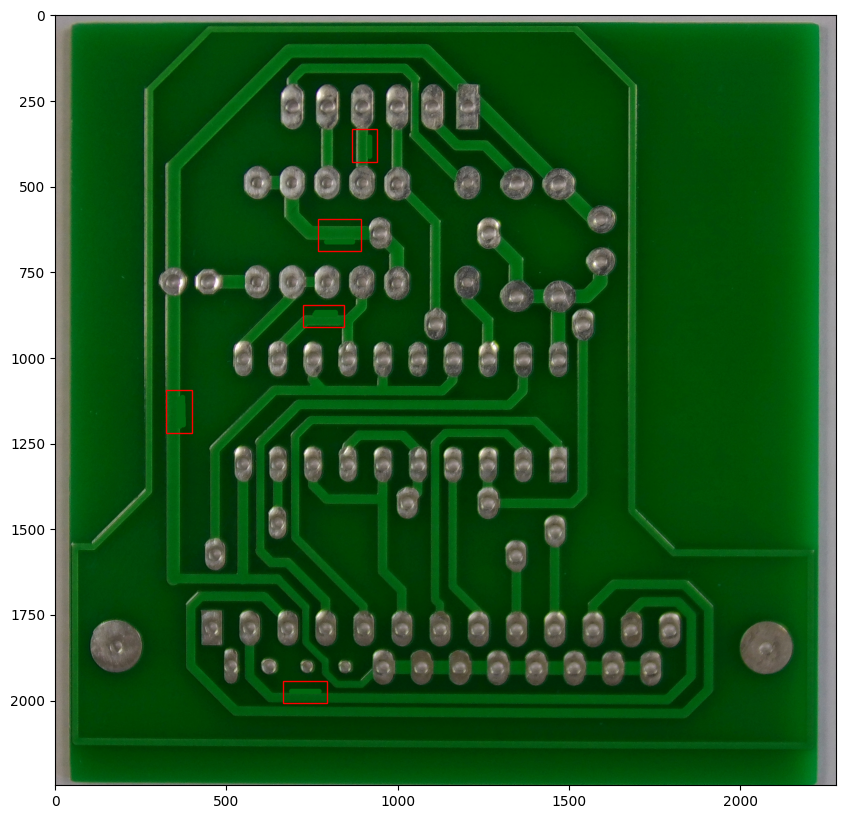

In [ ]:
name = train.file[405]
plot_image(name)

07_spurious_copper_08
[1029  936 1186  979]
[1736  851 1772  920]
[1306  850 1460  903]
[1358  477 1449  529]


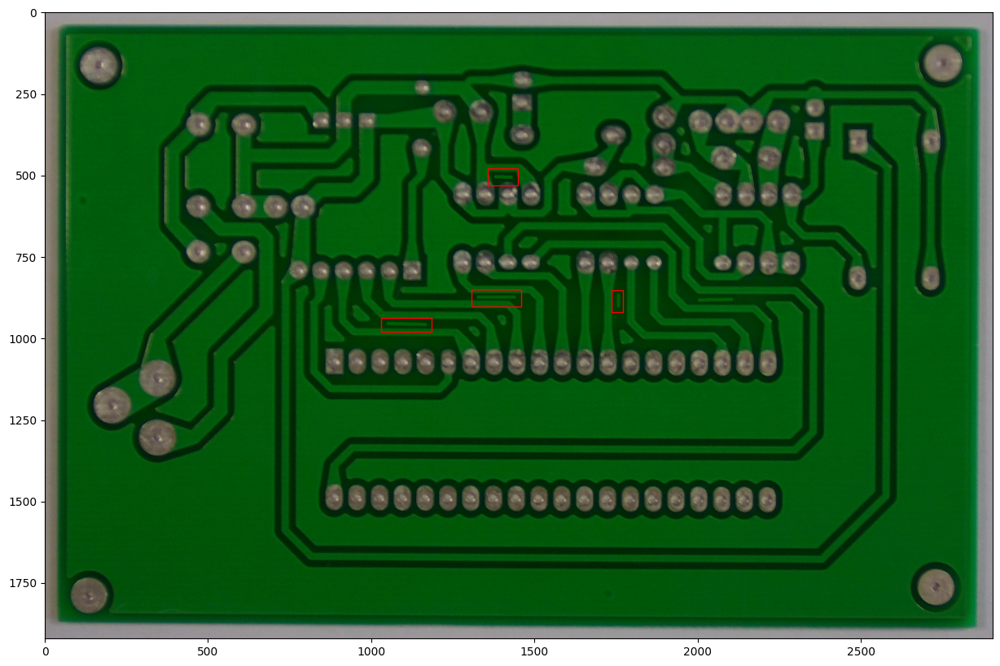

In [ ]:
name = train.file[555]
plot_image(name)

06_spurious_copper_09
[706 892 741 991]
[1172  429 1289  469]
[1497 1515 1591 1555]
[1055 1136 1114 1171]


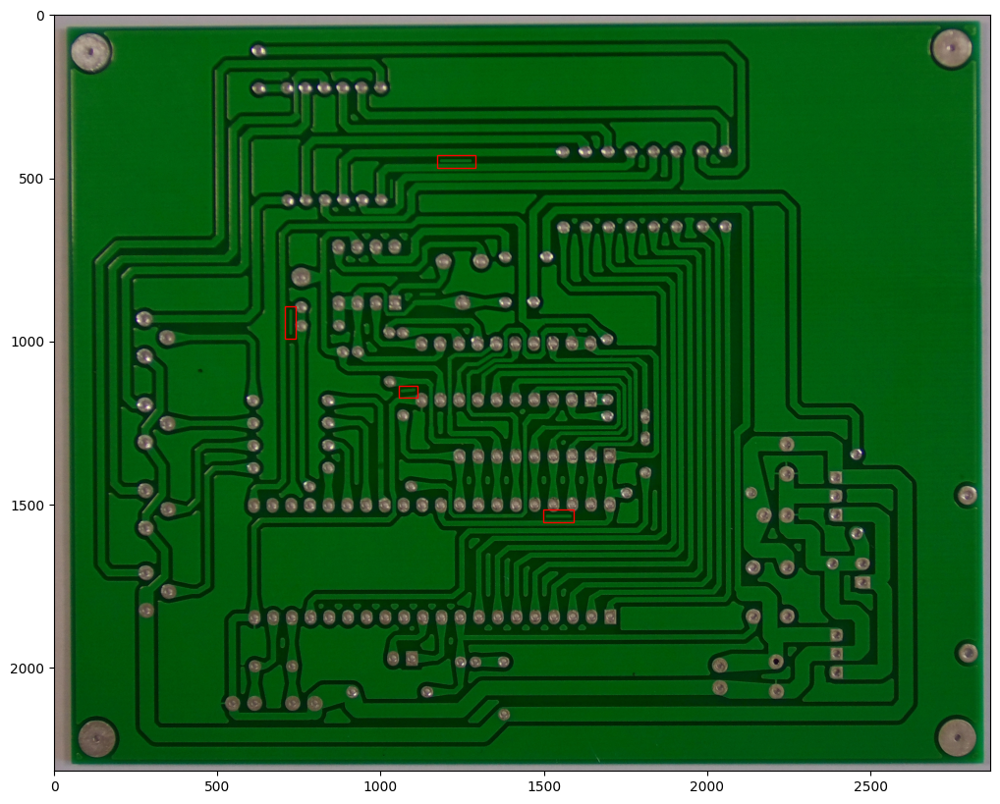

In [ ]:
name = train.file[595]
plot_image(name)

05_spurious_copper_10
[1867 1349 2027 1401]
[641 315 861 368]
[542 706 714 757]
[1525  656 1669  707]


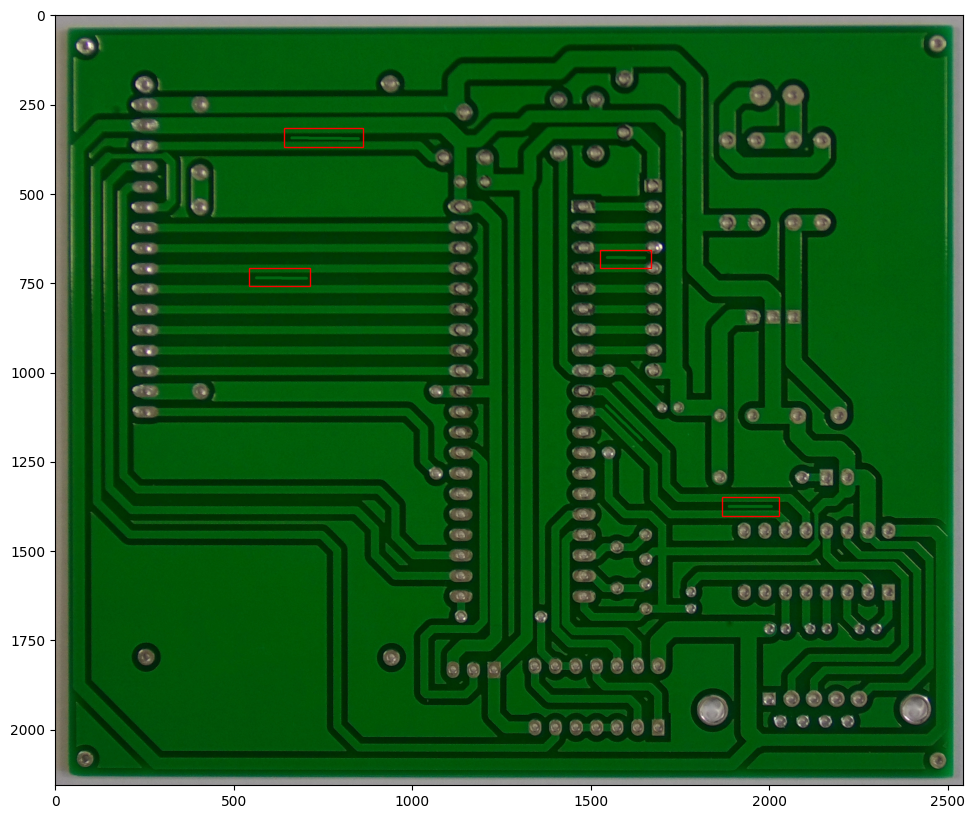

In [ ]:
name = train.file[677]
plot_image(name)

05_spur_07
[1991  418 2067  467]
[1872  756 1966  820]
[1828 1334 1906 1387]
[374 329 470 379]
[1224 1746 1305 1799]


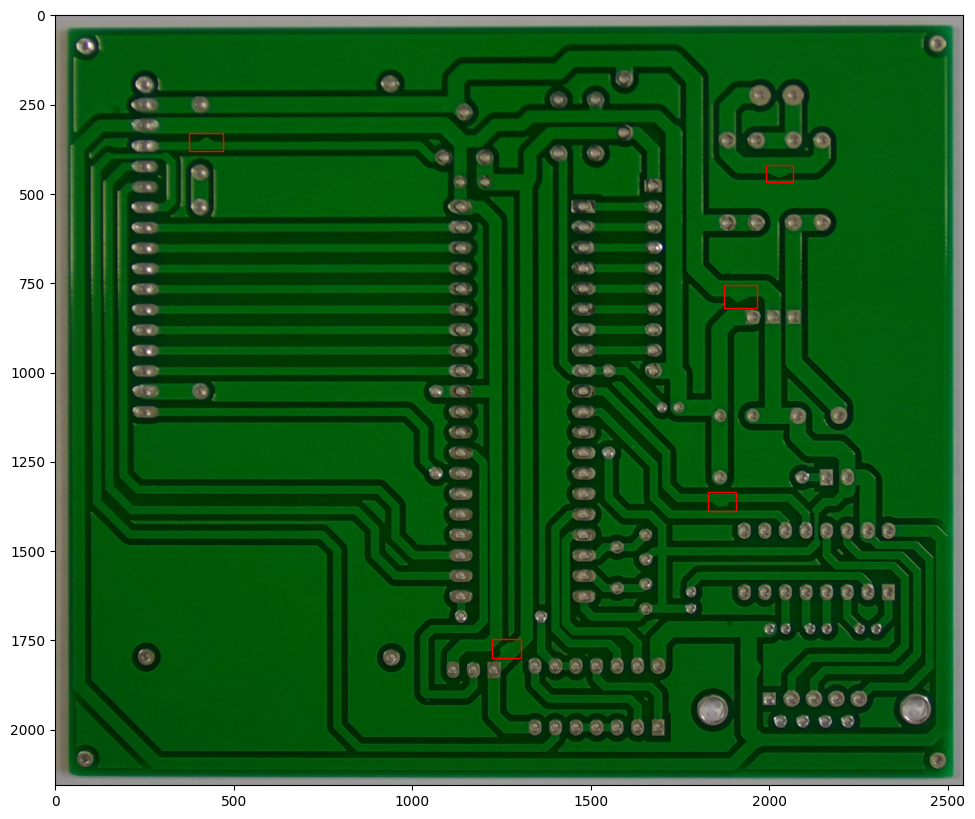

In [ ]:
name = train.file[150]
plot_image(name)

01_spurious_copper_03
[1810 1289 1846 1374]
[1539  866 1574  962]
[1854  948 1904 1043]


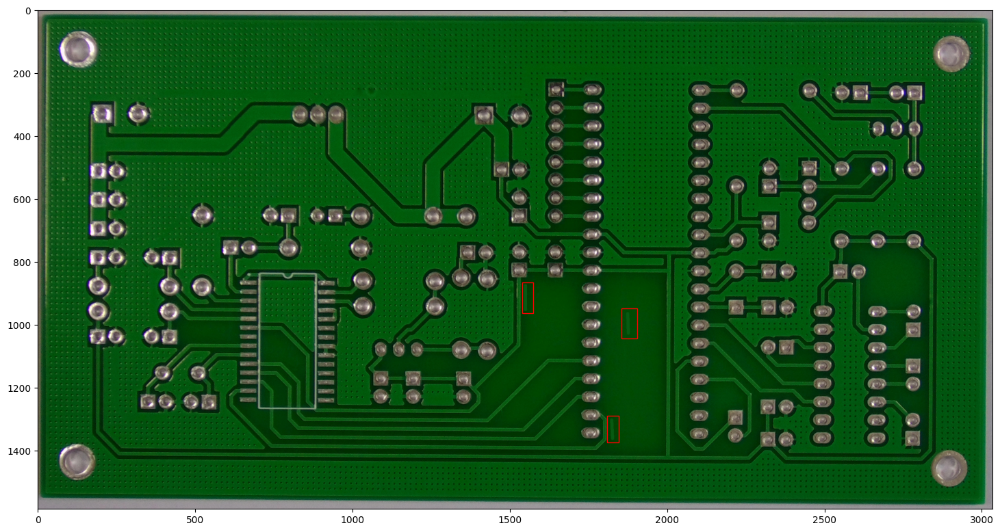

In [ ]:
name = train.file[505]
plot_image(name)

**Creating custom data base**

In [ ]:

class fcbData(object):
    def __init__(self, df, IMG_DIR, transforms):
        self.df = df
        self.img_dir = IMG_DIR
        self.image_ids = self.df['file'].unique().tolist()
        self.transforms = transforms

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        a = ''
        if "missing" in image_id.split('_'):
            a = 'Missing_hole/'
        elif "mouse" in image_id.split('_'):
            a = 'Mouse_bite/'
        elif "open" in image_id.split('_'):
            a = 'Open_circuit/'
        elif "short" in image_id.split('_'):
            a = 'Short/'
        elif "spur" in image_id.split('_'):
            a = 'Spur/'
        elif "spurious" in image_id.split('_'):
            a = 'Spurious_copper/'
        image_values = self.df[self.df['file'] == image_id]
        image = cv2.imread(self.img_dir+a+image_id+".jpg",cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0

        boxes = image_values[['xmin', 'ymin', 'xmax', 'ymax']].to_numpy()
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])

        labels = image_values["class"].values
        labels = torch.tensor(labels)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['image_id'] = torch.tensor([idx])
        target['area'] = torch.as_tensor(area, dtype=torch.float32)
        target['iscrowd'] = torch.zeros(len(classes_la), dtype=torch.int64)

        if self.transforms:
            sample = {
                'image': image,
                'bboxes': target['boxes'],
                'labels': labels
            }

            sample = self.transforms(**sample)
            image = sample['image']

            target['boxes'] = torch.stack(tuple(map(torch.tensor, zip(*sample['bboxes'])))).permute(1, 0)

        return torch.tensor(image), target, image_id


In [ ]:
def get_train_transform():
    return A.Compose([
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

def get_valid_transform():
    return A.Compose([
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

In [ ]:
# df는 'df = train.Copy()' (즉, train data의 deep 복사본)
path ="/content/drive/MyDrive/Desktop/PCB_DATASET/images/"
fcb_dataset   = fcbData(df, path, get_train_transform())

In [ ]:
print(type(fcb_dataset[0]), len(fcb_dataset[0]), type(fcb_dataset[0][0]), type(fcb_dataset[0][1]), type(fcb_dataset[0][2]))

<class 'tuple'> 3 <class 'torch.Tensor'> <class 'dict'> <class 'str'>


In [ ]:
print([fcb_dataset[0][0], fcb_dataset[0][1], fcb_dataset[0][2]])

[tensor([[[0.6314, 0.6235, 0.6353,  ..., 0.6392, 0.6471, 0.6196],
         [0.6431, 0.6275, 0.6353,  ..., 0.6353, 0.6510, 0.6353],
         [0.6510, 0.6314, 0.6353,  ..., 0.6314, 0.6471, 0.6471],
         ...,
         [0.6118, 0.6118, 0.6314,  ..., 0.6157, 0.6157, 0.6157],
         [0.6118, 0.6078, 0.6235,  ..., 0.6196, 0.6196, 0.6196],
         [0.6235, 0.6039, 0.6039,  ..., 0.6196, 0.6275, 0.6314]],

        [[0.5882, 0.5804, 0.5922,  ..., 0.6000, 0.6078, 0.5804],
         [0.6000, 0.5843, 0.5922,  ..., 0.5961, 0.6118, 0.5961],
         [0.6078, 0.5882, 0.5922,  ..., 0.5922, 0.6078, 0.6078],
         ...,
         [0.5686, 0.5686, 0.5882,  ..., 0.5882, 0.5882, 0.5882],
         [0.5686, 0.5647, 0.5804,  ..., 0.5922, 0.5922, 0.5922],
         [0.5804, 0.5608, 0.5608,  ..., 0.5922, 0.6000, 0.6039]],

        [[0.6118, 0.6039, 0.6157,  ..., 0.6314, 0.6392, 0.6118],
         [0.6235, 0.6078, 0.6157,  ..., 0.6275, 0.6431, 0.6275],
         [0.6314, 0.6118, 0.6157,  ..., 0.6235, 0.6392, 0

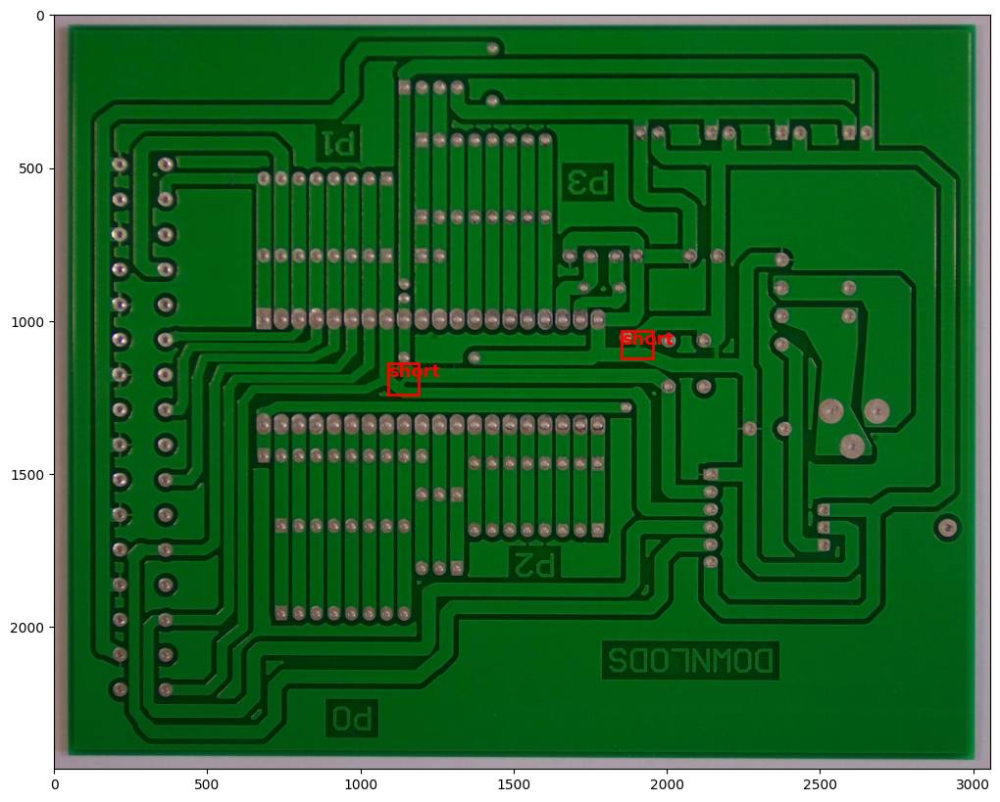

In [ ]:
img, tar, _ = fcb_dataset[random.randint(0,50)]
bbox = tar['boxes']
fig,ax = plt.subplots(figsize=(18,10))
ax.imshow(img.permute(1,2,0).cpu().numpy())
for j in tar["labels"].tolist():
    classes_la = {0:"missing_hole", 1: "mouse_bite", 2:"open_circuit",3: "short", 4:'spur',5:'spurious_copper'}
    l = classes_la[j]
    for i in range(len(bbox)):
        box = bbox[i]
        x,y,w,h = box[0], box[1], box[2]-box[0], box[3]-box[1]
        rect = matplotlib.patches.Rectangle((x,y),w,h,linewidth=2,edgecolor='r',facecolor='none',)
        ax.text(*box[:2], l, verticalalignment='top', color='red', fontsize=13, weight='bold')
        ax.add_patch(rect)
    plt.show()

In [ ]:
len(df)


2362

In [ ]:
image_ids = df['file'].unique()
valid_ids = image_ids[-665:]
train_ids = image_ids[:-665]
valid_df = df[df['file'].isin(valid_ids)]
train_df = df[df['file'].isin(train_ids)]
train_df.shape,valid_df.shape

((93, 8), (2269, 8))

**V. Dataloader**

In [ ]:
print(path)

/content/drive/MyDrive/Desktop/PCB_DATASET/images/


In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
train_dataset = fcbData(df, path, get_train_transform())
valid_dataset = fcbData(df, path, get_valid_transform())

# split the dataset in train and test set
indices = torch.randperm(len(train_dataset)).tolist()

train_data_loader = DataLoader(
    train_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=6,
    collate_fn=collate_fn
)

valid_data_loader = DataLoader(
    valid_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=6,
    collate_fn=collate_fn
)

In [ ]:
next(iter(train_data_loader))

((tensor([[[0.6314, 0.6235, 0.6353,  ..., 0.6392, 0.6471, 0.6196],
           [0.6431, 0.6275, 0.6353,  ..., 0.6353, 0.6510, 0.6353],
           [0.6510, 0.6314, 0.6353,  ..., 0.6314, 0.6471, 0.6471],
           ...,
           [0.6118, 0.6118, 0.6314,  ..., 0.6157, 0.6157, 0.6157],
           [0.6118, 0.6078, 0.6235,  ..., 0.6196, 0.6196, 0.6196],
           [0.6235, 0.6039, 0.6039,  ..., 0.6196, 0.6275, 0.6314]],
  
          [[0.5882, 0.5804, 0.5922,  ..., 0.6000, 0.6078, 0.5804],
           [0.6000, 0.5843, 0.5922,  ..., 0.5961, 0.6118, 0.5961],
           [0.6078, 0.5882, 0.5922,  ..., 0.5922, 0.6078, 0.6078],
           ...,
           [0.5686, 0.5686, 0.5882,  ..., 0.5882, 0.5882, 0.5882],
           [0.5686, 0.5647, 0.5804,  ..., 0.5922, 0.5922, 0.5922],
           [0.5804, 0.5608, 0.5608,  ..., 0.5922, 0.6000, 0.6039]],
  
          [[0.6118, 0.6039, 0.6157,  ..., 0.6314, 0.6392, 0.6118],
           [0.6235, 0.6078, 0.6157,  ..., 0.6275, 0.6431, 0.6275],
           [0.6314, 0.

Most pretrained models are trained with a background class, we'll include it in our model, so in that case our number of classes will be 6

In [ ]:
## num_classes = 6 # + background
num_classes = 6

# load a model; pre-trained on COCO
# .. fpn = 'feature pyramid network'
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)


# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features

# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 87.8MB/s]


In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
model.to(device)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=0.0001, weight_decay=0.0005,)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [ ]:
num_epochs = 1

**VI. Training and evaluation**

In [ ]:
train_data_loader

In [ ]:
import sys
best_epoch = 0
min_loss = sys.maxsize

for epoch in range(num_epochs):
    tk = tqdm(train_data_loader)
    model.train();
    for images, targets, image_ids in tk:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        tk.set_postfix(train_loss=loss_value)
    tk.close()

    # update the learning rate
    if lr_scheduler is not None:
        lr_scheduler.step()

    print(f"Epoch #{epoch} loss: {loss_value}")

    #validation
    model.eval();
    with torch.no_grad():
        tk = tqdm(valid_data_loader)
        for images, targets, image_ids in tk:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            val_output = model(images)
            val_output = [{k: v.to(device) for k, v in t.items()} for t in val_output]
            IOU = []
            for j in range(len(val_output)):
                a,b = val_output[j]['boxes'].cpu().detach(), targets[j]['boxes'].cpu().detach()
                chk = torchvision.ops.box_iou(a,b)
                res = np.nanmean(chk.sum(axis=1)/(chk>0).sum(axis=1))
                IOU.append(res)
            tk.set_postfix(IoU=np.mean(IOU))
        tk.close()

  0%|          | 0/692 [00:00<?, ?it/s]

Epoch #0 loss: 0.28958862260421603


  0%|          | 0/692 [00:00<?, ?it/s]

Sample evaluation on validation dataset image

In [ ]:
img,target,_ = valid_dataset[3]
# put the model in evaluation mode
model.eval()
with torch.no_grad():
    prediction = model([img.to(device)])[0]

print('predicted #boxes: ', len(prediction['boxes']))
print('real #boxes: ', len(target['boxes']))

predicted #boxes:  14
real #boxes:  3


In [ ]:
torch.save(model.state_dict(), 'pcbdetection.pt')

**VII. Evaluation**

In [ ]:
y_true =[]
y_pred = []
for i in range(50):
    img,target,_ = valid_dataset[i]
    model.eval()
    with torch.no_grad():
        prediction = model([img.to(device)])[0]

        if len(target['labels']) > 0 and len(prediction['labels']) > 0:
          y_true.append(target['labels'][0])
          y_pred.append(prediction['labels'][0])

In [ ]:
y_pred

[tensor(1, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(1, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(1, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(4, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(5, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(1, device='cuda:0'),
 tensor(5, device='cuda:0'),
 tensor(5, device='cuda:0'),
 tensor(1, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(4, device='cuda:0'),
 tensor(5, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(1, device='cuda:0'),
 tensor(5, device='cuda:0'),
 tensor(3, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(2, device='cuda:0'),
 tensor(1, dev

In [ ]:
yy_pred = []
for v in y_pred:
    yy_pred.append(v.cpu())

In [ ]:
yy_pred

[tensor(1),
 tensor(3),
 tensor(1),
 tensor(2),
 tensor(3),
 tensor(3),
 tensor(2),
 tensor(1),
 tensor(3),
 tensor(4),
 tensor(2),
 tensor(5),
 tensor(2),
 tensor(3),
 tensor(1),
 tensor(5),
 tensor(5),
 tensor(1),
 tensor(3),
 tensor(4),
 tensor(5),
 tensor(2),
 tensor(3),
 tensor(2),
 tensor(2),
 tensor(2),
 tensor(3),
 tensor(3),
 tensor(1),
 tensor(5),
 tensor(3),
 tensor(2),
 tensor(2),
 tensor(2),
 tensor(1),
 tensor(3),
 tensor(3),
 tensor(5),
 tensor(4),
 tensor(3),
 tensor(2),
 tensor(3),
 tensor(1),
 tensor(4),
 tensor(3),
 tensor(4),
 tensor(4),
 tensor(5),
 tensor(5),
 tensor(2)]

In [ ]:
y_true

[tensor(1),
 tensor(3),
 tensor(1),
 tensor(2),
 tensor(3),
 tensor(3),
 tensor(2),
 tensor(1),
 tensor(0),
 tensor(4),
 tensor(3),
 tensor(5),
 tensor(2),
 tensor(3),
 tensor(1),
 tensor(5),
 tensor(0),
 tensor(1),
 tensor(3),
 tensor(5),
 tensor(5),
 tensor(0),
 tensor(0),
 tensor(2),
 tensor(2),
 tensor(2),
 tensor(3),
 tensor(0),
 tensor(1),
 tensor(5),
 tensor(0),
 tensor(2),
 tensor(0),
 tensor(1),
 tensor(1),
 tensor(3),
 tensor(3),
 tensor(5),
 tensor(5),
 tensor(3),
 tensor(2),
 tensor(3),
 tensor(1),
 tensor(5),
 tensor(3),
 tensor(5),
 tensor(4),
 tensor(0),
 tensor(0),
 tensor(2)]

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_true, yy_pred)

array([[ 0,  0,  2,  4,  0,  3],
       [ 0,  8,  1,  0,  0,  0],
       [ 0,  0,  9,  0,  0,  0],
       [ 0,  0,  1, 11,  0,  0],
       [ 0,  0,  0,  0,  2,  0],
       [ 0,  0,  0,  0,  4,  5]])

In [ ]:
# classification_report로 평가 지표 확인하기
# .. https://blog.naver.com/PostView.naver?blogId=hannaurora&logNo=222498671200&parentCategoryNo=&categoryNo=41&viewDate=&isShowPopularPosts=true&from=search
from sklearn.metrics import classification_report
print(classification_report(y_true, yy_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         9
           1       1.00      0.89      0.94         9
           2       0.69      1.00      0.82         9
           3       0.73      0.92      0.81        12
           4       0.33      1.00      0.50         2
           5       0.62      0.56      0.59         9

    accuracy                           0.70        50
   macro avg       0.56      0.73      0.61        50
weighted avg       0.61      0.70      0.64        50



Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 195MB/s]


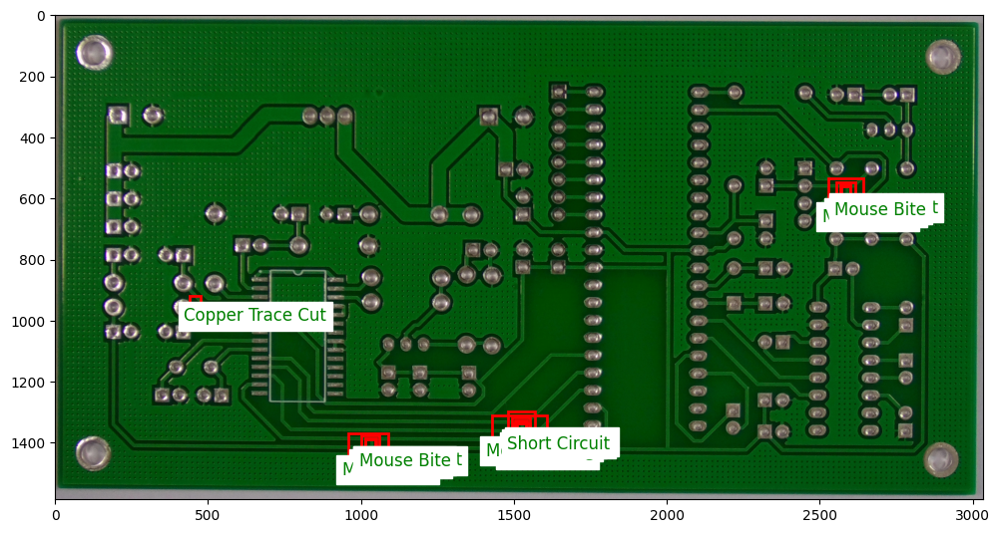

In [ ]:
# Define the device for inference (CPU or GPU)
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

defect_names = {
1: "Open Circuit",
2: "Short Circuit",
3: "Mouse Bite",
4: "Spur",
5: "Copper Trace Cut"
}
# Load the model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False, num_classes=6)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=6)
model.load_state_dict(torch.load('/content/pcbdetection.pt'))
model.eval()
model.to(device)

# Load the image
image_path = '/content/drive/MyDrive/Desktop/PCB_DATASET/images/Short/01_short_02.jpg'
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image = image / 255.0

# Define the transformation to apply to the image
transform = T.Compose([T.ToTensor()])

# Apply the transformation to the image
image = transform(image).to(device)

# Predict the bounding boxes and labels for the image
image = image.float()
outputs = model([image])
boxes = outputs[0]['boxes'].detach().cpu().numpy()
labels = outputs[0]['labels'].detach().cpu().numpy()

# Visualize the image and the predicted bounding boxes
fig, ax = plt.subplots(figsize=(12, 8))
ax.imshow(image.permute(1, 2, 0).cpu().numpy())
for box, label in zip(boxes, labels):
    x1, y1, x2, y2 = box
    w, h = x2 - x1, y2 - y1
    rect = matplotlib.patches.Rectangle((x1, y1), w, h, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    ax.text(x1-20, y2 + 50, defect_names[label], fontsize=12, color='g', backgroundcolor='w')
plt.show()
